## Assignment 1
## Cooper M. Stansbury
## UMID: 63919844

to show possible methods:
```r
print(methods(class=class(carseats)))
```

### config

In [1]:
library(leaps)
library(modelr)
library(mgcv)
library(ggplot2)
library(DataExplorer)
library(dplyr)
library(GGally)
library(ggExtra)
library(caret)
library(reshape2)
library(RColorBrewer)
library(plotly)

Loading required package: nlme
This is mgcv 1.8-26. For overview type 'help("mgcv-package")'.

Attaching package: ‘dplyr’

The following object is masked from ‘package:nlme’:

    collapse

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Attaching package: ‘GGally’

The following object is masked from ‘package:dplyr’:

    nasa

Loading required package: lattice

Attaching package: ‘plotly’

The following object is masked from ‘package:ggplot2’:

    last_plot

The following object is masked from ‘package:stats’:

    filter

The following object is masked from ‘package:graphics’:

    layout



In [2]:
sessionInfo()
sapply(c('repr', 'IRdisplay', 'IRkernel'), function(p) paste(packageVersion(p)))

R version 3.5.1 (2018-07-02)
Platform: x86_64-apple-darwin13.4.0 (64-bit)
Running under: macOS High Sierra 10.13.6

Matrix products: default
BLAS/LAPACK: /anaconda3/lib/R/lib/libRblas.dylib

locale:
[1] en_US.UTF-8/en_US.UTF-8/en_US.UTF-8/C/en_US.UTF-8/en_US.UTF-8

attached base packages:
[1] stats     graphics  grDevices utils     datasets  methods   base     

other attached packages:
 [1] plotly_4.8.0       RColorBrewer_1.1-2 reshape2_1.4.3     caret_6.0-81      
 [5] lattice_0.20-38    ggExtra_0.8        GGally_1.4.0       dplyr_0.8.0.1     
 [9] DataExplorer_0.7.0 ggplot2_3.1.0      mgcv_1.8-26        nlme_3.1-137      
[13] modelr_0.1.3       leaps_3.0         

loaded via a namespace (and not attached):
 [1] httr_1.4.0         tidyr_0.8.2        viridisLite_0.3.0  jsonlite_1.6      
 [5] splines_3.5.1      foreach_1.4.4      prodlim_2018.04.18 shiny_1.2.0       
 [9] assertthat_0.2.0   stats4_3.5.1       ipred_0.9-8        pillar_1.3.1      
[13] backports_1.1.3    glue_1.3.0   

repr IRdisplay  IRkernel 
 "0.19.2"   "0.7.0"  "0.8.15"

### View Raw Data

In [3]:
# show raw file via bash
print(system("head -n 5 data/Carseats_org.csv", intern=TRUE))

[1] "\"\",\"Sales\",\"CompPrice\",\"Income\",\"Advertising\",\"Population\",\"Price\",\"ShelveLoc\",\"Age\",\"Education\",\"Urban\",\"US\""
[2] "\"1\",9.5,138,73,11,276,120,\"Bad\",42,17,\"Yes\",\"Yes\""                                                                            
[3] "\"2\",11.22,111,48,16,260,83,\"Good\",65,10,\"Yes\",\"Yes\""                                                                          
[4] "\"3\",10.06,113,35,10,269,80,\"Medium\",59,12,\"Yes\",\"Yes\""                                                                        
[5] "\"4\",7.4,117,100,4,466,97,\"Medium\",55,14,\"Yes\",\"Yes\""                                                                          


# Part I

### 1.1 Import Data
Perform light cleaning and variable assignment. 

In [4]:
carseats <- read.csv("data/Carseats_org.csv", header = T, stringsAsFactors = T)

In [5]:
drops <- c("X")
carseats <- carseats[ , !(names(carseats) %in% drops)]
head(carseats, 10)

Sales,CompPrice,Income,Advertising,Population,Price,ShelveLoc,Age,Education,Urban,US
9.50,138,73,11,276,120,Bad,42,17,Yes,Yes
11.22,111,48,16,260,83,Good,65,10,Yes,Yes
10.06,113,35,10,269,80,Medium,59,12,Yes,Yes
7.40,117,100,4,466,97,Medium,55,14,Yes,Yes
4.15,141,64,3,340,128,Bad,38,13,Yes,No
10.81,124,113,13,501,72,Bad,78,16,No,Yes
6.63,115,105,0,45,108,Medium,71,15,Yes,No
11.85,136,81,15,425,120,Good,67,10,Yes,Yes
6.54,132,110,0,108,124,Medium,76,10,No,No
4.69,132,113,0,131,124,Medium,76,17,No,Yes


In [6]:
# get vectors of continuous and categorical cols
nums <- dplyr::select_if(carseats, is.numeric)
cats <- dplyr::select_if(carseats, is.factor)

nums[sample(nrow(nums), 10), ]

cats[sample(nrow(cats), 10), ]

,Sales,CompPrice,Income,Advertising,Population,Price,Age,Education
51,1.42,99,32,18,341,108,80,16
95,8.39,115,97,5,134,84,55,11
268,5.83,134,82,7,473,112,51,12
333,5.74,106,33,20,354,104,61,12
1,9.50,138,73,11,276,120,42,17
149,7.56,110,119,0,384,97,72,14
325,2.66,136,65,4,133,150,53,13
86,8.47,125,103,0,304,112,49,13
378,6.81,132,61,0,263,125,41,12
230,11.19,98,104,0,404,72,27,18


,ShelveLoc,Urban,US
240,Bad,Yes,Yes
325,Bad,Yes,Yes
186,Medium,Yes,Yes
100,Bad,No,Yes
276,Medium,Yes,Yes
316,Good,Yes,Yes
7,Medium,Yes,No
339,Medium,Yes,No
53,Bad,Yes,Yes
395,Bad,Yes,Yes


### 1.2 Dataset Dimensionality

In [7]:
str(carseats)

'data.frame':	400 obs. of  11 variables:
 $ Sales      : num  9.5 11.22 10.06 7.4 4.15 ...
 $ CompPrice  : int  138 111 113 117 141 124 115 136 132 132 ...
 $ Income     : int  73 48 35 100 64 113 105 81 110 113 ...
 $ Advertising: int  11 16 10 4 3 13 0 15 0 0 ...
 $ Population : int  276 260 269 466 340 501 45 425 108 131 ...
 $ Price      : int  120 83 80 97 128 72 108 120 124 124 ...
 $ ShelveLoc  : Factor w/ 3 levels "Bad","Good","Medium": 1 2 3 3 1 1 3 2 3 3 ...
 $ Age        : int  42 65 59 55 38 78 71 67 76 76 ...
 $ Education  : int  17 10 12 14 13 16 15 10 10 17 ...
 $ Urban      : Factor w/ 2 levels "No","Yes": 2 2 2 2 2 1 2 2 1 1 ...
 $ US         : Factor w/ 2 levels "No","Yes": 2 2 2 2 1 2 1 2 1 2 ...


In [8]:
print(paste('Number of Columns:', ncol(carseats)))
print(paste('Number of Numeric Columns:', ncol(nums)))
print(paste('Number of Categorical Columns:', ncol(cats)))

[1] "Number of Columns: 11"
[1] "Number of Numeric Columns: 8"
[1] "Number of Categorical Columns: 3"


In [9]:
# # get summary 
print(DataExplorer::introduce(data=carseats))

  rows columns discrete_columns continuous_columns all_missing_columns
1  400      11                3                  8                   0
  total_missing_values complete_rows total_observations memory_usage
1                    0           400               4400        24000


### Plotting with Plotly

In [81]:
plot_ly(data=carseats, 
        x=~Age, 
        y=~Sales, 
        mode = 'markers', 
        type = 'scatter', 
        color=~ShelveLoc) %>%
            layout(title = "Age, Shelf Location, and Sales Scatter Plot") 

HTML widgets cannot be represented in plain text (need html)

In [11]:
plot_ly(data=carseats, 
        x=~Price, 
        y=~Sales, 
        mode = 'markers', 
        type = 'scatter', 
        color=~ShelveLoc) %>%
            layout(title = "Price, Shelf Location, and Sales Scatter Plot")

HTML widgets cannot be represented in plain text (need html)

In [88]:
plot_ly(data=carseats, 
        x=~Price, 
        y=~Sales, 
        mode = 'markers', 
        type = 'scatter', 
        size=~Price,
        colors = "Set1",
        color = ~US,
        alpha = .6) %>%
            layout(title = "Price, US, and Sales Scatter Plot") 

Warning message:
“`line.width` does not currently support multiple values.”Warning message:
“`line.width` does not currently support multiple values.”

<iframe src="data:text/html;charset=utf-8;base64,PCFET0NUWVBFIGh0bWw+CjxodG1sPgo8aGVhZD4KPG1ldGEgY2hhcnNldD0idXRmLTgiIC8+Cjx0aXRsZT5wbG90bHk8L3RpdGxlPgo8c2NyaXB0PihmdW5jdGlvbigpIHsKICAvLyBJZiB3aW5kb3cuSFRNTFdpZGdldHMgaXMgYWxyZWFkeSBkZWZpbmVkLCB0aGVuIHVzZSBpdDsgb3RoZXJ3aXNlIGNyZWF0ZSBhCiAgLy8gbmV3IG9iamVjdC4gVGhpcyBhbGxvd3MgcHJlY2VkaW5nIGNvZGUgdG8gc2V0IG9wdGlvbnMgdGhhdCBhZmZlY3QgdGhlCiAgLy8gaW5pdGlhbGl6YXRpb24gcHJvY2VzcyAodGhvdWdoIG5vbmUgY3VycmVudGx5IGV4aXN0KS4KICB3aW5kb3cuSFRNTFdpZGdldHMgPSB3aW5kb3cuSFRNTFdpZGdldHMgfHwge307CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIGEgdmlld2VyIHBhbmUuIElmIG5vdCwgd2UncmUgaW4gYSB3ZWIgYnJvd3Nlci4KICB2YXIgdmlld2VyTW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy52aWV3ZXJNb2RlID0KICAgICAgL1xidmlld2VyX3BhbmU9MVxiLy50ZXN0KHdpbmRvdy5sb2NhdGlvbik7CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIFNoaW55IG1vZGUuIElmIG5vdCwgaXQncyBhIHN0YXRpYyBkb2N1bWVudC4KICAvLyBOb3RlIHRoYXQgc3RhdGljIHdpZGdldHMgY2FuIGFwcGVhciBpbiBib3RoIFNoaW55IGFuZCBzdGF0aWMgbW9kZXMsIGJ1dAogIC8vIG9idmlvdXNseSwgU2hpbnkgd2lkZ2V0cyBjYW4gb25seSBhcHBlYXIgaW4gU2hpbnkgYXBwcy9kb2N1bWVudHMuCiAgdmFyIHNoaW55TW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy5zaGlueU1vZGUgPQogICAgICB0eXBlb2Yod2luZG93LlNoaW55KSAhPT0gInVuZGVmaW5lZCIgJiYgISF3aW5kb3cuU2hpbnkub3V0cHV0QmluZGluZ3M7CgogIC8vIFdlIGNhbid0IGNvdW50IG9uIGpRdWVyeSBiZWluZyBhdmFpbGFibGUsIHNvIHdlIGltcGxlbWVudCBvdXIgb3duCiAgLy8gdmVyc2lvbiBpZiBuZWNlc3NhcnkuCiAgZnVuY3Rpb24gcXVlcnlTZWxlY3RvckFsbChzY29wZSwgc2VsZWN0b3IpIHsKICAgIGlmICh0eXBlb2YoalF1ZXJ5KSAhPT0gInVuZGVmaW5lZCIgJiYgc2NvcGUgaW5zdGFuY2VvZiBqUXVlcnkpIHsKICAgICAgcmV0dXJuIHNjb3BlLmZpbmQoc2VsZWN0b3IpOwogICAgfQogICAgaWYgKHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwpIHsKICAgICAgcmV0dXJuIHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwoc2VsZWN0b3IpOwogICAgfQogIH0KCiAgZnVuY3Rpb24gYXNBcnJheSh2YWx1ZSkgewogICAgaWYgKHZhbHVlID09PSBudWxsKQogICAgICByZXR1cm4gW107CiAgICBpZiAoJC5pc0FycmF5KHZhbHVlKSkKICAgICAgcmV0dXJuIHZhbHVlOwogICAgcmV0dXJuIFt2YWx1ZV07CiAgfQoKICAvLyBJbXBsZW1lbnQgalF1ZXJ5J3MgZXh0ZW5kCiAgZnVuY3Rpb24gZXh0ZW5kKHRhcmdldCAvKiwgLi4uICovKSB7CiAgICBpZiAoYXJndW1lbnRzLmxlbmd0aCA9PSAxKSB7CiAgICAgIHJldHVybiB0YXJnZXQ7CiAgICB9CiAgICBmb3IgKHZhciBpID0gMTsgaSA8IGFyZ3VtZW50cy5sZW5ndGg7IGkrKykgewogICAgICB2YXIgc291cmNlID0gYXJndW1lbnRzW2ldOwogICAgICBmb3IgKHZhciBwcm9wIGluIHNvdXJjZSkgewogICAgICAgIGlmIChzb3VyY2UuaGFzT3duUHJvcGVydHkocHJvcCkpIHsKICAgICAgICAgIHRhcmdldFtwcm9wXSA9IHNvdXJjZVtwcm9wXTsKICAgICAgICB9CiAgICAgIH0KICAgIH0KICAgIHJldHVybiB0YXJnZXQ7CiAgfQoKICAvLyBJRTggZG9lc24ndCBzdXBwb3J0IEFycmF5LmZvckVhY2guCiAgZnVuY3Rpb24gZm9yRWFjaCh2YWx1ZXMsIGNhbGxiYWNrLCB0aGlzQXJnKSB7CiAgICBpZiAodmFsdWVzLmZvckVhY2gpIHsKICAgICAgdmFsdWVzLmZvckVhY2goY2FsbGJhY2ssIHRoaXNBcmcpOwogICAgfSBlbHNlIHsKICAgICAgZm9yICh2YXIgaSA9IDA7IGkgPCB2YWx1ZXMubGVuZ3RoOyBpKyspIHsKICAgICAgICBjYWxsYmFjay5jYWxsKHRoaXNBcmcsIHZhbHVlc1tpXSwgaSwgdmFsdWVzKTsKICAgICAgfQogICAgfQogIH0KCiAgLy8gUmVwbGFjZXMgdGhlIHNwZWNpZmllZCBtZXRob2Qgd2l0aCB0aGUgcmV0dXJuIHZhbHVlIG9mIGZ1bmNTb3VyY2UuCiAgLy8KICAvLyBOb3RlIHRoYXQgZnVuY1NvdXJjZSBzaG91bGQgbm90IEJFIHRoZSBuZXcgbWV0aG9kLCBpdCBzaG91bGQgYmUgYSBmdW5jdGlvbgogIC8vIHRoYXQgUkVUVVJOUyB0aGUgbmV3IG1ldGhvZC4gZnVuY1NvdXJjZSByZWNlaXZlcyBhIHNpbmdsZSBhcmd1bWVudCB0aGF0IGlzCiAgLy8gdGhlIG92ZXJyaWRkZW4gbWV0aG9kLCBpdCBjYW4gYmUgY2FsbGVkIGZyb20gdGhlIG5ldyBtZXRob2QuIFRoZSBvdmVycmlkZGVuCiAgLy8gbWV0aG9kIGNhbiBiZSBjYWxsZWQgbGlrZSBhIHJlZ3VsYXIgZnVuY3Rpb24sIGl0IGhhcyB0aGUgdGFyZ2V0IHBlcm1hbmVudGx5CiAgLy8gYm91bmQgdG8gaXQgc28gInRoaXMiIHdpbGwgd29yayBjb3JyZWN0bHkuCiAgZnVuY3Rpb24gb3ZlcnJpZGVNZXRob2QodGFyZ2V0LCBtZXRob2ROYW1lLCBmdW5jU291cmNlKSB7CiAgICB2YXIgc3VwZXJGdW5jID0gdGFyZ2V0W21ldGhvZE5hbWVdIHx8IGZ1bmN0aW9uKCkge307CiAgICB2YXIgc3VwZXJGdW5jQm91bmQgPSBmdW5jdGlvbigpIHsKICAgICAgcmV0dXJuIHN1cGVyRnVuYy5hcHBseSh0YXJnZXQsIGFyZ3VtZW50cyk7CiAgICB9OwogICAgdGFyZ2V0W21ldGhvZE5hbWVdID0gZnVuY1NvdXJjZShzdXBlckZ1bmNCb3VuZCk7CiAgfQoKICAvLyBBZGQgYSBtZXRob2QgdG8gZGVsZWdhdG9yIHRoYXQsIHdoZW4gaW52b2tlZCwgY2FsbHMKICAvLyBkZWxlZ2F0ZWUubWV0aG9kTmFtZS4gSWYgdGhlcmUgaXMgbm8gc3VjaCBtZXRob2Qgb24KICAvLyB0aGUgZGVsZWdhdGVlLCBidXQgdGhlcmUgd2FzIG9uZSBvbiBkZWxlZ2F0b3IgYmVmb3JlCiAgLy8gZGVsZWdhdGVNZXRob2Qgd2FzIGNhbGxlZCwgdGhlbiB

### Normalization

In [13]:
# normalize continuous columns
preObj <- preProcess(nums, method=c("center", "scale"))
scaled.nums <- predict(preObj, nums)

head(scaled.nums)

Sales,CompPrice,Income,Advertising,Population,Price,Age,Education
0.70948774,0.84939126,0.1551667,0.6563550,0.07572445,0.1776010,-0.6989069,1.18296763
1.31852808,-0.91134302,-0.7381360,1.4081936,-0.03284107,-1.3851191,0.7208201,-1.48824960
0.90777994,-0.78091826,-1.2026533,0.5059873,0.02822704,-1.5118261,0.3504565,-0.72504468
-0.03410803,-0.52006873,1.1199335,-0.3962189,1.36494005,-0.7938196,0.1035475,0.03816025
-1.18491100,1.04502840,-0.1664223,-0.5465866,0.50998655,0.5154865,-0.9458160,-0.34344221
1.17334986,-0.06358207,1.5844509,0.9570904,1.60242713,-1.8497116,1.5232746,0.80136517


### Distributions (Numeric Columns)
Using `ggplot2`, because `plotly` doesn't handle this well yet.

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


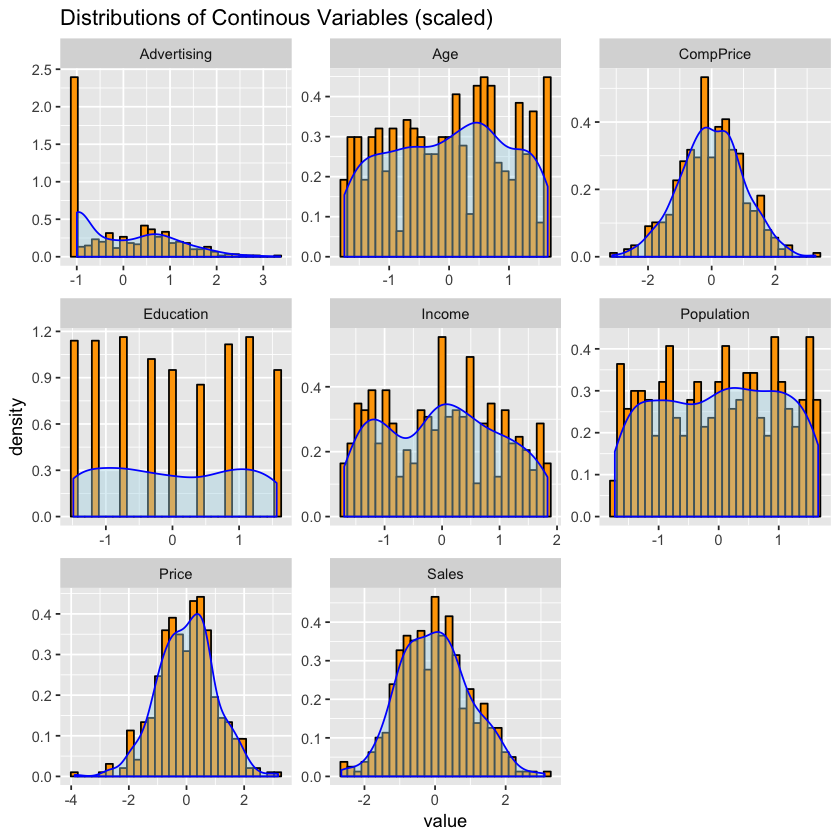

In [14]:
scaled.nums %>%
    tidyr::gather() %>% 
        ggplot(aes(x=value,y=..density..))+

            ggtitle('Distributions of Continous Variables (scaled)') +

            facet_wrap(~ key, scales = "free") +
            geom_histogram(fill=I("orange"), col=I("black")) +

            facet_wrap(~ key, scales = "free") +
            geom_density(color="blue", fill='light blue', alpha = 0.4)

In [15]:
scaled.nums %>%
    tidyr::gather() %>% 
        plot_ly(x=~key, y=~value,
                type = "box", 
                boxpoints = "all", 
                jitter = 0.4,
                pointpos = 0,
                color = ~key,
                colors = "Dark2") %>%
                      subplot(shareX = TRUE)  %>%
                            layout(title = "Numeric Variable Distributions (scaled)", 
                                  yaxis=list(title='Standard Deviation'),
                                  xaxis=list(title='Variable'),
                                  autosize=FALSE,
                                  width=900,
                                  height=900)

Warning message:
“Specifying width/height in layout() is now deprecated.
Please specify in ggplotly() or plot_ly()”

HTML widgets cannot be represented in plain text (need html)

### 1.3 Scatterplots

In [48]:
scaled.nums %>%
    tidyr::gather(-Sales, key = "var", value = "value") %>%
    split(.$var) %>%
       lapply(function(d) plot_ly(d, x=~value, y=~Sales, 
                mode = 'markers', 
                type = 'scatter',
                colors = 'Set3',
                size = ~Sales^2,
                marker = list(line = list(
                color = 'black',
                width = 2)),
                name=~var)) %>%
                      subplot(nrows=7, shareY=TRUE)  %>%
                            layout(title = "Scatterplot Numeric vs Sales (scaled)<br>Size=Sales^2",
                                   autosize=FALSE,
                                   width=900,
                                   height=1500,
                                   yaxis=list(title='Sales'))

Warning message:
“`line.width` does not currently support multiple values.”Warning message:
“`line.width` does not currently support multiple values.”Warning message:
“`line.width` does not currently support multiple values.”Warning message:
“`line.width` does not currently support multiple values.”Warning message:
“`line.width` does not currently support multiple values.”Warning message:
“`line.width` does not currently support multiple values.”Warning message:
“`line.width` does not currently support multiple values.”Warning message:
“Specifying width/height in layout() is now deprecated.
Please specify in ggplotly() or plot_ly()”

HTML widgets cannot be represented in plain text (need html)

In [34]:
fit.Pop <- lm(Sales ~ Population, data = scaled.nums)
fit.Age <- lm(Sales ~ Age, data = scaled.nums)
fit.CompPrice <- lm(Sales ~ CompPrice, data = scaled.nums)
fit.Price <- lm(Sales ~ Price, data = scaled.nums)

p1 <-  plot_ly(scaled.nums, 
               x = ~Population,
               name = 'Population vs Sales Regression Line') %>% 
                   add_markers(y = ~Sales,
                               name = 'Population vs Sales Observations') %>% 
                                    add_lines(x = ~Population, 
                                              y = fitted(fit.Pop)) 
p2 <-  plot_ly(scaled.nums, 
               x = ~Age,
               name = 'Age vs Sales Regression Line') %>% 
                   add_markers(y = ~Sales,
                               name = 'Age vs Sales Observations') %>% 
                                    add_lines(x = ~Age, 
                                              y = fitted(fit.Age)) 

p3 <-  plot_ly(scaled.nums, 
               x = ~CompPrice,
               name = 'CompPrice vs Sales Regression Line') %>% 
                   add_markers(y = ~Sales,
                               name = 'CompPrice vs Sales Observations') %>% 
                                    add_lines(x = ~CompPrice, 
                                              y = fitted(fit.CompPrice)) 

p4 <-  plot_ly(scaled.nums, 
               x = ~Price,
               name = 'Price vs Sales Regression Line') %>% 
                   add_markers(y = ~Sales,
                               name = 'Price vs Sales Observations') %>% 
                                    add_lines(x = ~Price, 
                                              y = fitted(fit.Price)) 

subplot(p1, p2, p3, p4, nrows=2, shareY=TRUE) %>%
    layout(title = "Scatterplot Numeric vs Sales (scaled) <br> With Regression Lines",
           autosize=FALSE,
           width=1000,
           height=700,
           yaxis=list(title='Sales'))


Warning message:
“Specifying width/height in layout() is now deprecated.
Please specify in ggplotly() or plot_ly()”

HTML widgets cannot be represented in plain text (need html)

In [47]:
scaled.nums %>%
    plot_ly(y = ~Sales) %>%
      add_lines(x= ~Population, y = fitted(fit.Pop), 
                name = "fit.Pop slope", line = list(shape = "linear")) %>%
      add_lines(x= ~Age, y = fitted(fit.Age), 
                name = "fit.Age slope", line = list(shape = "linear")) %>%
      add_lines(x= ~CompPrice, y = fitted(fit.CompPrice), 
                name = "fit.CompPrice slope", line = list(shape = "linear")) %>%
      add_lines(x= ~Price, y = fitted(fit.Price), 
                name = "fit.Price slope", line = list(shape = "linear")) %>%
            
    layout(title = "Regression Lines vs Sales (scaled)",
           autosize=FALSE,
           width=700,
           height=500,
           yaxis=list(title='Sales'),
           xaxis=list(title='Scaled Numeric Variable'))


Warning message:
“Specifying width/height in layout() is now deprecated.
Please specify in ggplotly() or plot_ly()”

HTML widgets cannot be represented in plain text (need html)

In [58]:
y = scaled.nums$Sales
x = scaled.nums$Price

s <- subplot(
  plot_ly(x = x, color = I("black"), type = 'histogram'), 
  plotly_empty(), 
  plot_ly(x = x, y = y, type = 'histogram2dcontour', showscale = F), 
  plot_ly(y = y, color = I("black"), type = 'histogram'),
  nrows = 2, heights = c(0.2, 0.8), widths = c(0.8, 0.2),
  shareX = TRUE, shareY = TRUE, titleX = FALSE, titleY = FALSE
)

layout(s, showlegend = FALSE, autosize=FALSE,
           width=700,
           height=500, 
           yaxis=list(title='Sales'),
           xaxis=list(title='Price'))

Warning message:
“No trace type specified and no positional attributes specified”No trace type specified:
  Based on info supplied, a 'scatter' trace seems appropriate.
  Read more about this trace type -> https://plot.ly/r/reference/#scatter
No scatter mode specifed:
  Setting the mode to markers
  Read more about this attribute -> https://plot.ly/r/reference/#scatter-mode
Warning message:
“Specifying width/height in layout() is now deprecated.
Please specify in ggplotly() or plot_ly()”

HTML widgets cannot be represented in plain text (need html)

### 1.4 Sales by Categorical Variables

In [62]:
categorical.by.sales = cbind(Sales = scaled.nums$Sales, cats)

# sample colors to make each subplot more unique
colr = brewer.pal(9, "Set1")

categorical.by.sales %>%
    tidyr::gather(-Sales, key = "var", value = "value") %>%
    split(.$var) %>%
       lapply(function(d) plot_ly(d, x=~paste(var, '<br>' , value), y=~Sales,
                type = "box", 
                boxpoints = "all", 
                jitter = .2,
                pointpos = 0,
                color =~paste(var, ":", value),
                colors = sample(colr, length(unique(d$value))))) %>%
#                 colors = "Set1")) %>%
                      subplot(shareY = TRUE, nrows=3)  %>%
                            layout(title = "Categorical Variable Distributions vs Sales (scaled)", 
                                  yaxis=list(title='Sales Standard Deviation'),
                                  xaxis=list(title=''),
                                  autosize=FALSE,
                                  width=900,
                                  height=1500)
              
# help(layout)

Warning message:
“attributes are not identical across measure variables;
they will be dropped”Warning message:
“Specifying width/height in layout() is now deprecated.
Please specify in ggplotly() or plot_ly()”

HTML widgets cannot be represented in plain text (need html)

In [78]:
categorical.by.sales %>%               
    plot_ly(x = ~US, y = ~Sales,
        split = ~US,
        type = 'violin',
        box = list(visible = TRUE),
        meanline = list(visible = TRUE)) %>% 
              layout(xaxis = list(title = "US"),
                     yaxis = list(title = "Sales",zeroline = FALSE))

HTML widgets cannot be represented in plain text (need html)

In [75]:
categorical.by.sales %>%               
    plot_ly(x = ~Urban, y = ~Sales,
        split = ~Urban,
        type = 'violin',
        box = list(visible = TRUE),
        meanline = list(visible = TRUE)) %>% 
              layout(xaxis = list(title = "Urban"),
                     yaxis = list(title = "Sales",zeroline = FALSE))

HTML widgets cannot be represented in plain text (need html)

In [74]:
categorical.by.sales %>%               
    plot_ly(x = ~ShelveLoc, y = ~Sales,
        split = ~ShelveLoc,
        type = 'violin',
        box = list(visible = TRUE),
        meanline = list(visible = TRUE)) %>% 
              layout(xaxis = list(title = "ShelveLoc"),
                     yaxis = list(title = "Sales",zeroline = FALSE))

HTML widgets cannot be represented in plain text (need html)

### 1.5 Linear Regression